# Preparação dos Dados

In [1]:
!mkdir -p /data/sets/nuscenes  # Make the directory to store the nuScenes dataset in.

!wget https://www.nuscenes.org/data/v1.0-mini.tgz  # Download the nuScenes mini split.

!tar -xf v1.0-mini.tgz -C /data/sets/nuscenes  # Uncompress the nuScenes mini split.

!pip install nuscenes-devkit &> /dev/null  # Install nuScenes.

--2024-05-11 00:54:02--  https://www.nuscenes.org/data/v1.0-mini.tgz
Resolving www.nuscenes.org (www.nuscenes.org)... 108.156.120.75, 108.156.120.2, 108.156.120.114, ...
Connecting to www.nuscenes.org (www.nuscenes.org)|108.156.120.75|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4167696325 (3.9G) [application/x-tar]
Saving to: ‘v1.0-mini.tgz.2’

v1.0-mini.tgz.2     100%[===================>]   3.88G  85.4MB/s    in 49s     

2024-05-11 00:54:51 (81.1 MB/s) - ‘v1.0-mini.tgz.2’ saved [4167696325/4167696325]



In [2]:
!pip install filterpy
from nuscenes.nuscenes import NuScenes
import pandas as pd
from filterpy.kalman import KalmanFilter
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error
from scipy.spatial import distance



nusc = NuScenes(version='v1.0-mini', dataroot='/data/sets/nuscenes', verbose=True)


columns = ['category_name', 'instance_token', 'translation', 'size', 'rotation']
annotations_df = pd.DataFrame(columns=columns)


for my_sample in nusc.sample:

    for annotation_token in my_sample['anns']:

        annotation_metadata = nusc.get('sample_annotation', annotation_token)
        instance_metadata = nusc.get('instance', annotation_metadata['instance_token'])
        category_metadata = nusc.get('category', instance_metadata['category_token'])


        data = {
            'category_name': category_metadata['name'],
            'instance_token': annotation_metadata['instance_token'],
            'translation': annotation_metadata['translation'],
            'size': annotation_metadata['size'],
            'rotation': annotation_metadata['rotation']
        }


        annotations_df = pd.concat([annotations_df, pd.DataFrame([data])], ignore_index=True)


print(annotations_df.head())


annotations_df.to_csv('annotations.csv', index=False)


Loading NuScenes tables for version v1.0-mini...
23 category,
8 attribute,
4 visibility,
911 instance,
12 sensor,
120 calibrated_sensor,
31206 ego_pose,
8 log,
10 scene,
404 sample,
31206 sample_data,
18538 sample_annotation,
4 map,
Done loading in 2.714 seconds.
Reverse indexing ...
Done reverse indexing in 0.3 seconds.
                category_name                    instance_token  \
0      human.pedestrian.adult  6dd2cbf4c24b4caeb625035869bca7b5   
1      human.pedestrian.adult  48d58b69b40149aeb2e64aa4b1a9192f   
2                 vehicle.car  bd26c2cdb22d4bb1834e808c89128898   
3      human.pedestrian.adult  6e04e175f20d402f8cbbdf701fe99d92   
4  movable_object.trafficcone  4a5a657f59914516bade8551072e5ab0   

                  translation                   size  \
0    [373.256, 1130.419, 0.8]  [0.621, 0.669, 1.642]   
1  [378.888, 1153.348, 0.865]  [0.775, 0.769, 1.711]   
2  [353.794, 1132.355, 0.602]  [2.011, 4.633, 1.573]   
3   [376.13, 1158.507, 0.938]  [0.752, 0.819, 1.63

In [3]:
columns = ['scene_token', 'category_name', 'instance_token', 'translation', 'size', 'rotation']
annotations_df = pd.DataFrame(columns=columns)


for scene in nusc.scene:
    scene_token = scene['token']
    sample_token = scene['first_sample_token']


    while sample_token:
        my_sample = nusc.get('sample', sample_token)
        for annotation_token in my_sample['anns']:
            annotation_metadata = nusc.get('sample_annotation', annotation_token)
            instance_metadata = nusc.get('instance', annotation_metadata['instance_token'])
            category_metadata = nusc.get('category', instance_metadata['category_token'])

            data = {
                'scene_token': scene_token,
                'category_name': category_metadata['name'],
                'instance_token': annotation_metadata['instance_token'],
                'translation': annotation_metadata['translation'],
                'size': annotation_metadata['size'],
                'rotation': annotation_metadata['rotation']
            }

            annotations_df = pd.concat([annotations_df, pd.DataFrame([data])], ignore_index=True)


        sample_token = my_sample['next']


annotations_df.to_csv('annotations_with_scenes.csv', index=False)


In [4]:

categories_of_interest = [
    'human.pedestrian.adult',
    'human.pedestrian.child',
    'human.pedestrian.construction_worker',
    'human.pedestrian.personal_mobility',
    'human.pedestrian.police_officer'
]


filtered_annotations_df = annotations_df[annotations_df['category_name'].isin(categories_of_interest)]


print(filtered_annotations_df.head())


                        scene_token           category_name  \
0  cc8c0bf57f984915a77078b10eb33198  human.pedestrian.adult   
1  cc8c0bf57f984915a77078b10eb33198  human.pedestrian.adult   
3  cc8c0bf57f984915a77078b10eb33198  human.pedestrian.adult   
6  cc8c0bf57f984915a77078b10eb33198  human.pedestrian.adult   
8  cc8c0bf57f984915a77078b10eb33198  human.pedestrian.adult   

                     instance_token                 translation  \
0  6dd2cbf4c24b4caeb625035869bca7b5    [373.256, 1130.419, 0.8]   
1  48d58b69b40149aeb2e64aa4b1a9192f  [378.888, 1153.348, 0.865]   
3  6e04e175f20d402f8cbbdf701fe99d92   [376.13, 1158.507, 0.938]   
6  c08be936e0394352b11760ede982d6fd  [378.657, 1151.026, 0.833]   
8  bbd6c47a20e34276bc6f2cfbc6ba6205  [396.335, 1122.142, 0.513]   

                    size                                           rotation  
0  [0.621, 0.669, 1.642]  [0.9831098797903927, 0.0, 0.0, -0.183016295062...  
1  [0.775, 0.769, 1.711]  [-0.5527590208259255, 0.0, 0.0, 0.83

# Criaçao e aplicação do Filtro de Kalman

In [5]:
def setup_kalman_filter():
    kf = KalmanFilter(dim_x=6, dim_z=3)
    kf.x = np.zeros((6,))  # posição inicial e velocidade
    dt = 1  # intervalo de tempo entre as medições
    kf.F = np.array([[1, 0, 0, dt, 0, 0],
                     [0, 1, 0, 0, dt, 0],
                     [0, 0, 1, 0, 0, dt],
                     [0, 0, 0, 1, 0, 0],
                     [0, 0, 0, 0, 1, 0],
                     [0, 0, 0, 0, 0, 1]])
    kf.H = np.array([[1, 0, 0, 0, 0, 0],
                     [0, 1, 0, 0, 0, 0],
                     [0, 0, 1, 0, 0, 0]])
    kf.Q = np.eye(6) * 0.1  # Process noise
    kf.R = np.eye(3) * 1  # Measurement noise
    kf.P *= 10  # Covariance matrix
    return kf


predicted_df = pd.DataFrame(columns=['instance_token', 'predicted_positions'])


for token in filtered_annotations_df['instance_token'].unique():
    kf = setup_kalman_filter()
    instance_data = filtered_annotations_df[filtered_annotations_df['instance_token'] == token]
    predictions = []

    for _, row in instance_data.iterrows():

        translation = np.array(row['translation'])
        kf.predict()
        kf.update(translation)
        predictions.append(kf.x[:3].tolist())


    new_row = pd.DataFrame([{
        'instance_token': token,
        'predicted_positions': predictions if predictions else None
    }])
    predicted_df = pd.concat([predicted_df, new_row], ignore_index=True)

predicted_df.head()
predicted_df.to_csv('predictions.csv', index=False)



In [6]:

expanded_predicted_df = pd.DataFrame(columns=['instance_token', 'frame', 'predicted_position'])


for token in predicted_df['instance_token']:
    instance_data = predicted_df[predicted_df['instance_token'] == token]
    for idx, row in instance_data.iterrows():
        frame_predictions = row['predicted_positions']
        if frame_predictions is not None:
            for frame, prediction in enumerate(frame_predictions):
                new_row = {
                    'instance_token': token,
                    'frame': frame + 1,
                    'predicted_position': prediction
                }
                expanded_predicted_df = pd.concat([expanded_predicted_df, pd.DataFrame([new_row])], ignore_index=True)

expanded_predicted_df.head()
expanded_predicted_df.to_csv('expanded_predictions.csv', index=False)



# Análise de Resultados

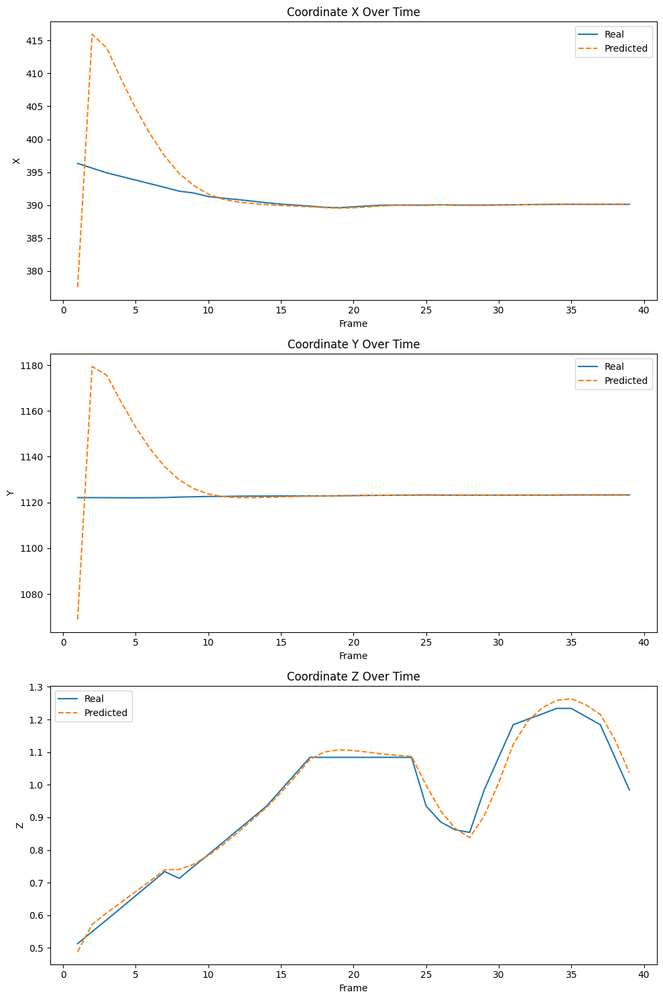

In [7]:
instance_token_input = 'bbd6c47a20e34276bc6f2cfbc6ba6205'


filtered_data = filtered_annotations_df[filtered_annotations_df['instance_token'] == instance_token_input]
predicted_data = expanded_predicted_df[expanded_predicted_df['instance_token'] == instance_token_input]


real_positions = filtered_data['translation'].tolist()
predicted_positions = predicted_data['predicted_position'].tolist()
frames = predicted_data['frame'].tolist()


fig, axes = plt.subplots(3, 1, figsize=(10, 15))


coords = ['X', 'Y', 'Z']

for i in range(3):
    real_coords = [pos[i] for pos in real_positions]
    pred_coords = [pos[i] for pos in predicted_positions]

    axes[i].plot(frames, real_coords, label='Real')
    axes[i].plot(frames, pred_coords, label='Predicted', linestyle='--')
    axes[i].set_title(f'Coordinate {coords[i]} Over Time')
    axes[i].set_xlabel('Frame')
    axes[i].set_ylabel(coords[i])
    axes[i].legend()

plt.tight_layout()
plt.show()


/usr/local/lib/python3.10/dist-packages/nuscenes/nuscenes.py:1493: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(1, 2, figsize=(18, 9))


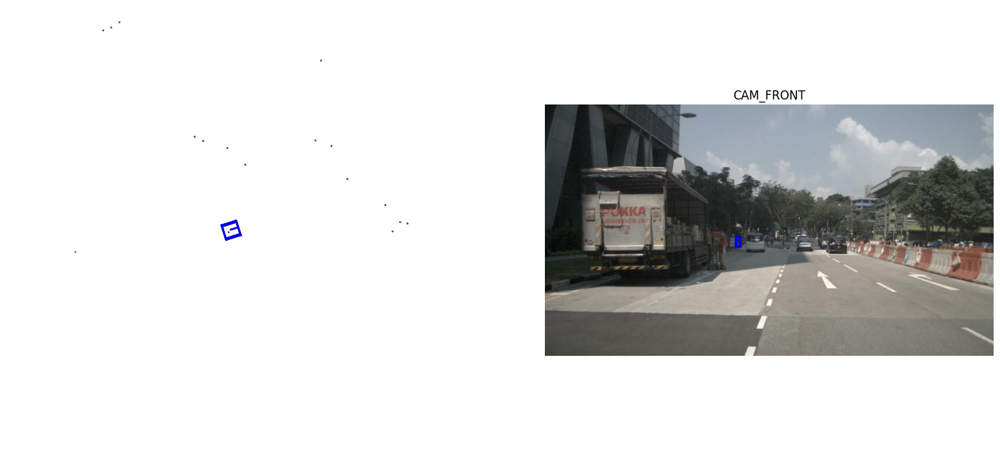

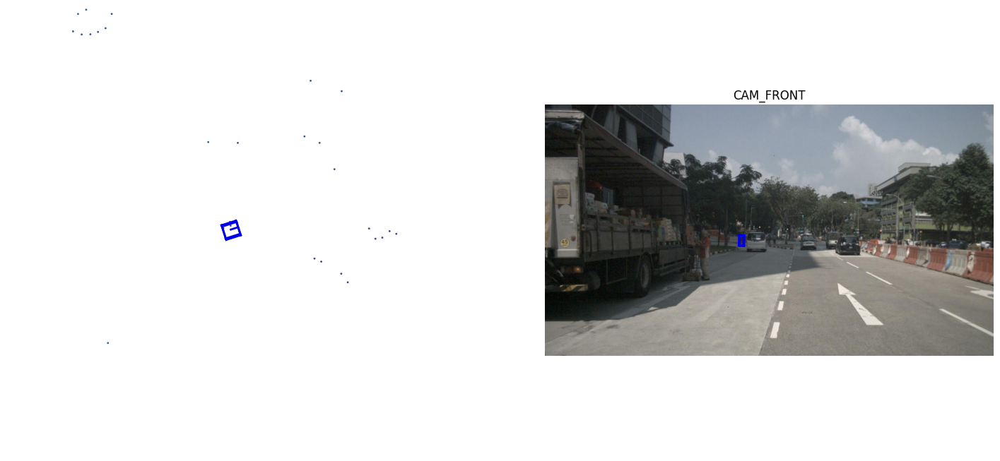

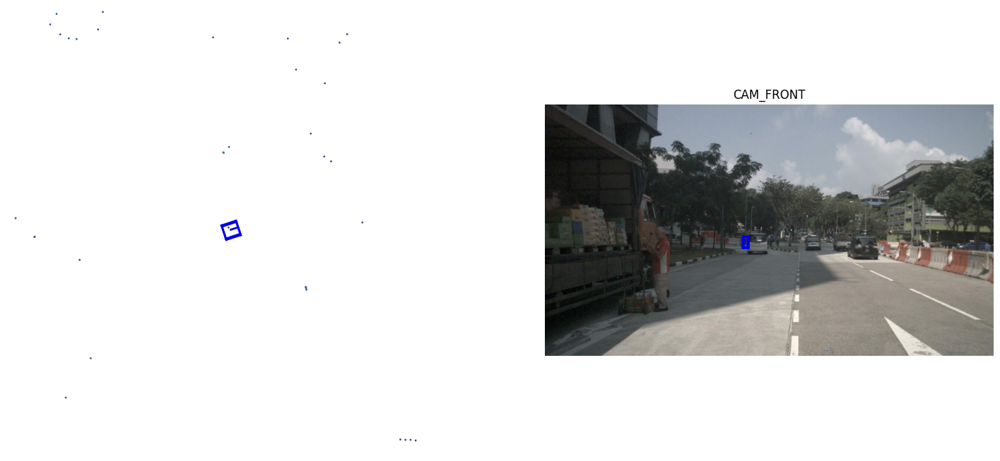

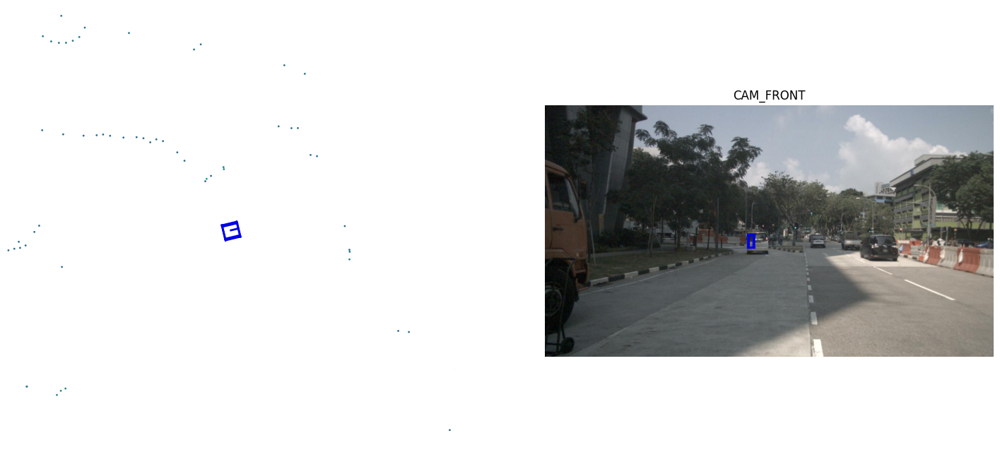

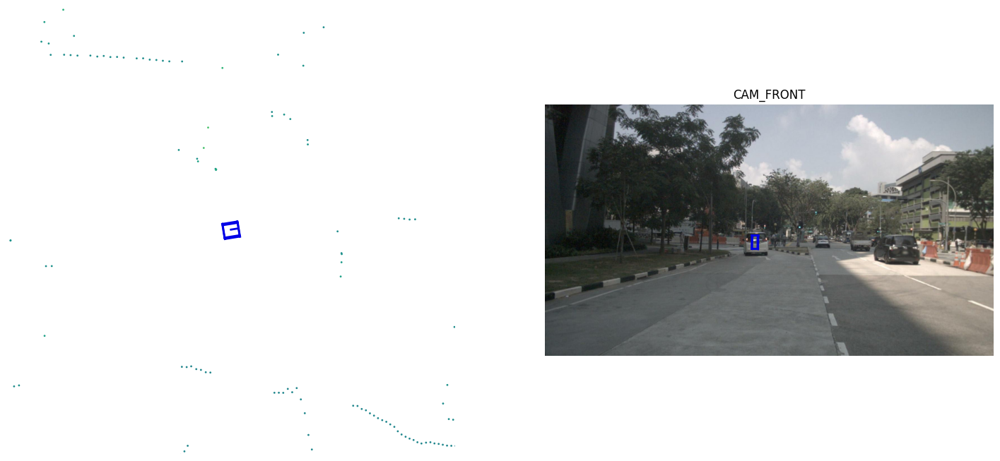

...

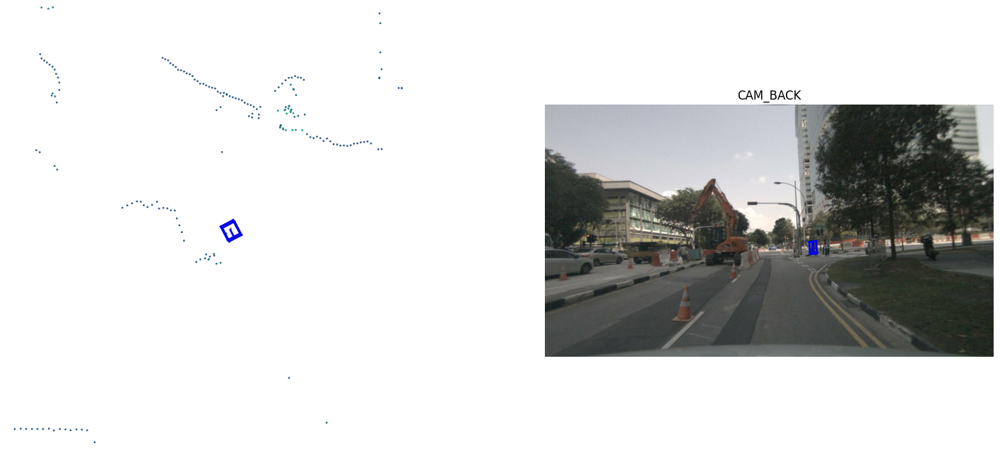

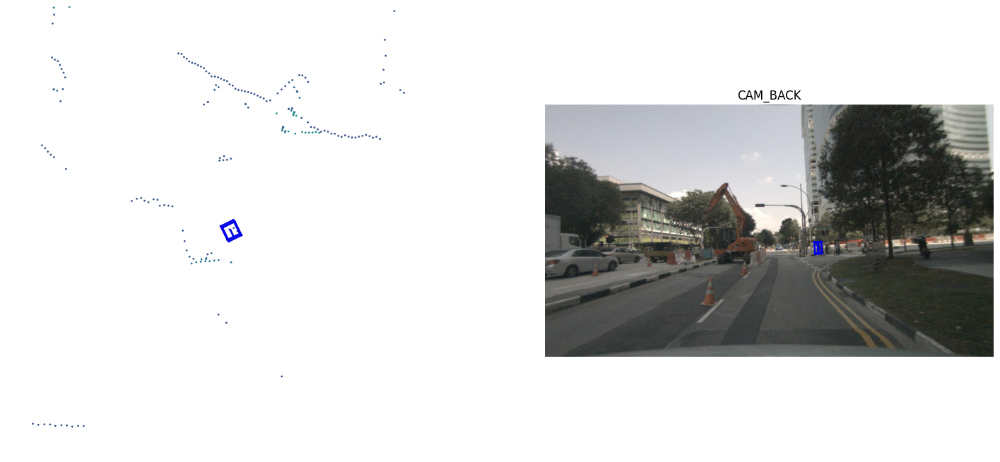

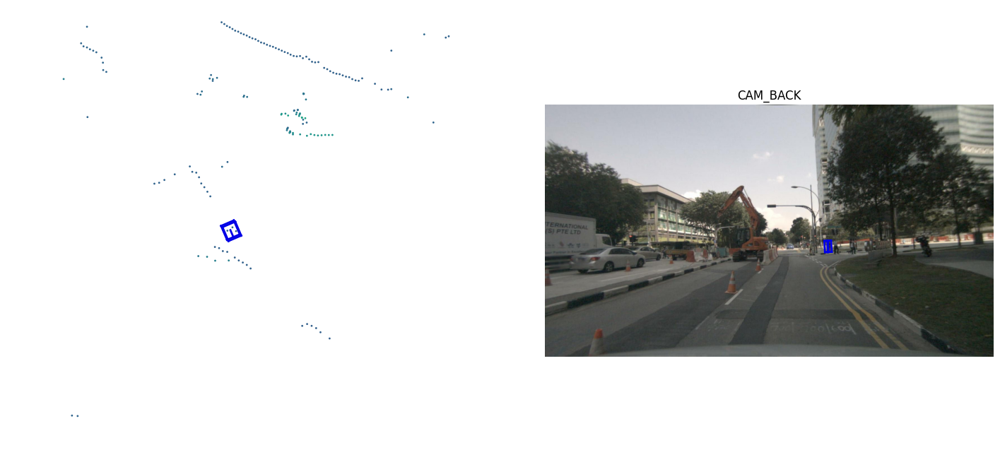

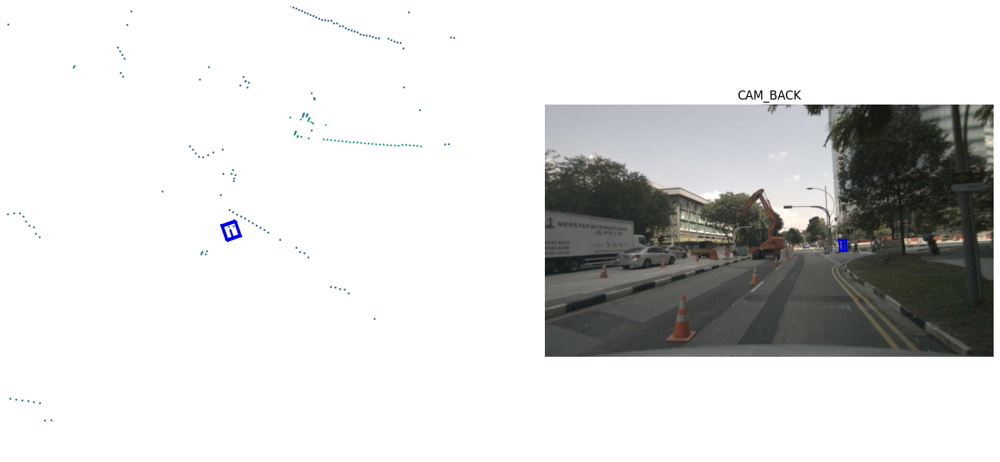

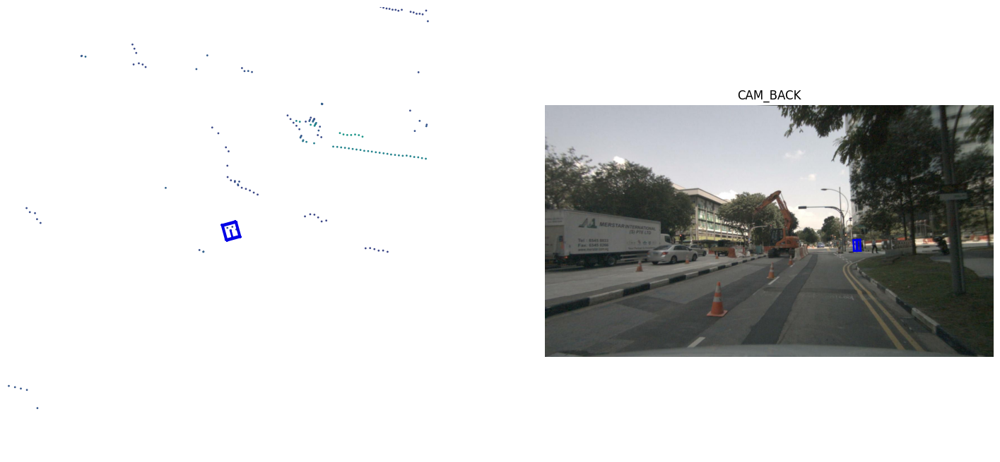

In [8]:
#Exemplo de como a biblioteca nuscenes renderiza o bounding box em uma cena
scene_token = 'cc8c0bf57f984915a77078b10eb33198'
scene = nusc.get('scene', scene_token)
sample_token = scene['first_sample_token']

specific_instance_token = 'bbd6c47a20e34276bc6f2cfbc6ba6205'
#uma instancia possui anotações (bounding box)

while sample_token:
    sample = nusc.get('sample', sample_token)

    # Encontrar anotações para o token de instância específico no frame atual
    ann_tokens = [ann_token for ann_token in sample['anns'] if nusc.get('sample_annotation', ann_token)['instance_token'] == specific_instance_token]

    # Renderiza a bounding box para a anotação da instancia escolhida
    for ann_token in ann_tokens:
        nusc.render_annotation(ann_token)

    # Atualizar para o próximo sample
    sample_token = nusc.get('sample', sample_token)['next']


In [9]:
# Carregar os dados
annotations_with_scenes_df = pd.read_csv('annotations_with_scenes.csv')
expanded_predictions_df = pd.read_csv('expanded_predictions.csv')
expanded_predictions_df['predicted_position'] = expanded_predictions_df['predicted_position'].apply(eval)

# Faz o merge dos dataframes de predição e de dados reais
merged_df = pd.merge(annotations_with_scenes_df, expanded_predictions_df, on='instance_token')

merged_df['translation'] = merged_df['translation'].apply(eval)

# Função para calcular a distância euclidiana
def calculate_euclidean(row):
    return distance.euclidean(row['translation'], row['predicted_position'])


# Calcula MSE e MAE para as coordenadas X, Y, Z
mse_x = mean_squared_error(merged_df['translation'].apply(lambda x: x[0]), merged_df['predicted_position'].apply(lambda x: x[0]))
mse_y = mean_squared_error(merged_df['translation'].apply(lambda x: x[1]), merged_df['predicted_position'].apply(lambda x: x[1]))
mse_z = mean_squared_error(merged_df['translation'].apply(lambda x: x[2]), merged_df['predicted_position'].apply(lambda x: x[2]))
mae_x = mean_absolute_error(merged_df['translation'].apply(lambda x: x[0]), merged_df['predicted_position'].apply(lambda x: x[0]))
mae_y = mean_absolute_error(merged_df['translation'].apply(lambda x: x[1]), merged_df['predicted_position'].apply(lambda x: x[1]))
mae_z = mean_absolute_error(merged_df['translation'].apply(lambda x: x[2]), merged_df['predicted_position'].apply(lambda x: x[2]))

# Adicionando a distância euclidiana ao DataFrame e calcula a média no dataframe
merged_df['euclidean_distance'] = merged_df.apply(calculate_euclidean, axis=1)
mean_euclidean_distance = merged_df['euclidean_distance'].mean()

print("MSE X: ", mse_x)
print("MSE Y: ", mse_y)
print("MSE Z: ", mse_z)
print("MAE X: ", mae_x)
print("MAE Y: ", mae_y)
print("MAE Z: ", mae_z)
print("Média da distância Euclidiana: ", mean_euclidean_distance)


MSE X:  424.1649769813622
MSE Y:  675.3768762245163
MSE Z:  0.1593961717640136
MAE X:  10.630980202229818
MAE Y:  14.04023621164439
MAE Z:  0.25216915147378555
Média da distância Euclidiana:  18.48860130543392


In [10]:
#Como vimos no gráfico, pelo fato de o filtro de kalman ter como estado inicial a posição zero, isso faz com que ele demore alguns frames para se adequar a posição/comportamento correto.
# Filtrar os DataFrames para incluir apenas entradas com pelo menos 10 frames
filtered_expanded_predictions_df = expanded_predictions_df[expanded_predictions_df['frame'] >= 10]

merged_df = pd.merge(annotations_with_scenes_df, filtered_expanded_predictions_df, on='instance_token')

# Verificar se existem instâncias com menos de 10 frames e se sim, remove estes casos
instance_frame_counts = filtered_expanded_predictions_df['instance_token'].value_counts()
valid_instances = instance_frame_counts[instance_frame_counts >= 10].index
merged_df = merged_df[merged_df['instance_token'].isin(valid_instances)]

merged_df['translation'] = merged_df['translation'].apply(eval)

# Calcula MSE e MAE para as coordenadas X, Y, Z
mse_x = mean_squared_error(merged_df['translation'].apply(lambda x: x[0]), merged_df['predicted_position'].apply(lambda x: x[0]))
mse_y = mean_squared_error(merged_df['translation'].apply(lambda x: x[1]), merged_df['predicted_position'].apply(lambda x: x[1]))
mse_z = mean_squared_error(merged_df['translation'].apply(lambda x: x[2]), merged_df['predicted_position'].apply(lambda x: x[2]))
mae_x = mean_absolute_error(merged_df['translation'].apply(lambda x: x[0]), merged_df['predicted_position'].apply(lambda x: x[0]))
mae_y = mean_absolute_error(merged_df['translation'].apply(lambda x: x[1]), merged_df['predicted_position'].apply(lambda x: x[1]))
mae_z = mean_absolute_error(merged_df['translation'].apply(lambda x: x[2]), merged_df['predicted_position'].apply(lambda x: x[2]))

merged_df['euclidean_distance'] = merged_df.apply(calculate_euclidean, axis=1)
mean_euclidean_distance = merged_df['euclidean_distance'].mean()

print("MSE X: ", mse_x)
print("MSE Y: ", mse_y)
print("MSE Z: ", mse_z)
print("MAE X: ", mae_x)
print("MAE Y: ", mae_y)
print("MAE Z: ", mae_z)
print("Média da distância Euclidiana: ", mean_euclidean_distance)


MSE X:  23.86762050949667
MSE Y:  23.046591219501025
MSE Z:  0.12529526397966723
MAE X:  3.0626623853471133
MAE Y:  3.1981868006575898
MAE Z:  0.22089212396137153
Média da distância Euclidiana:  4.731552679812062
